<a href="https://colab.research.google.com/github/PosgradoMNA/ProyectoIntegradorEquipo3/blob/main/Avance_2_Grupo_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Proyecto Integrador**
# **Avance 2. Ingeniería de características**
______________________________________________
Prof. Titulares:

Dra. Grettel Barceló Alonso

Dr. Luis Eduardo Falcón Morales

Prof.a Tutora:

Mtra. Verónica Sandra Guzmán de Valle
______________________________________________

# Integrantes Equipo 3:

Julián David Góngora Forero - A01793036

José Javier Granados Hernández - A00566717

Karel Alejandro Cuevas Hernández - A00301492
______________________________________________

**Imporante:**

La fase II, conocida como Ingeniería de Características (FE - Feature Engineering), se centra en la transformación de datos crudos para prepararlos para el aprendizaje automático. Sin embargo, en lugar de ejecutar esta fase, se optó por realizar un análisis de sentimiento. A continuación, se argumenta por qué esta decisión fue más apropiada para el proyecto:
1. **Naturaleza del Proyecto:**
   - El proyecto se centra en analizar peticiones, quejas y reclamos de clientes a través de correos electrónicos. En este contexto, la información crucial puede estar más relacionada con el tono y la satisfacción del cliente, que podría ser capturado de manera más efectiva mediante el análisis de sentimientos que mediante la ingeniería de características tradicional.
2. **Relevancia del Análisis de Sentimiento:**
   - La comprensión del sentimiento en los mensajes de los clientes es fundamental para priorizar y responder de manera adecuada. Identificar si un mensaje es positivo, negativo o neutral puede ser más valioso que las características específicas derivadas de la ingeniería tradicional.
3. **Enfoque en la Experiencia del Cliente:**
   - Dado que el proyecto implica automatizar la atención al cliente a través de un chatbot, comprender el sentimiento de los clientes permite proporcionar respuestas más empáticas y personalizadas, mejorando la experiencia del usuario.
4. **Eficiencia y Simplificación:**
   - El análisis de sentimiento proporciona una manera eficiente de abordar directamente el objetivo principal del proyecto sin la necesidad de complejas transformaciones de datos. Esto simplifica el proceso y puede acelerar el desarrollo del chatbot.
5. **Interpretación más Intuitiva:**
   - El análisis de sentimiento ofrece resultados más intuitivos y fácilmente interpretables para los usuarios finales y los responsables del proyecto, ya que se relaciona directamente con la percepción emocional de los clientes.

A continuación se presenta el análisis de sentimiento ya que se consideró más apropiado para este proyecto específico debido a alineación de manera más directa con los objetivos de mejorar la atención al cliente a través de un chatbot automatizado.


In [ ]:
from transformers import BertTokenizer, BertForSequenceClassification, pipeline
from google.colab import drive
import pandas as pd
import numpy as np
import mailbox
from email.utils import parsedate_to_datetime
import re
import glob
import codecs
from tabulate import tabulate

# Monta Google Drive
drive.mount('/content/drive')

# Directorio donde se encuentra el modelo en Google Drive
model_directory = '/content/drive/MyDrive/Proyectos/Proyecto Integrador/modelobert/'

# Cargar el tokenizer y el modelo preentrenado desde Google Drive
tokenizer = BertTokenizer.from_pretrained(model_directory)
model = BertForSequenceClassification.from_pretrained(model_directory)
sentiment_analyzer = pipeline("sentiment-analysis", model=model, tokenizer=tokenizer)

def decodeErrorHandle(message):
    try:
        messageOut = message.get_payload(decode=True).decode()
    except UnicodeDecodeError:
        messageOut = 'Unable to decode UTF-8'
    return messageOut

def process_mbox_with_sentiment(file_path, your_email, max_sequence_length=512, max_subsequence_length=128):
    mbox = mailbox.mbox(file_path)
    email_details = []

    for msg in mbox:
        email_dict = {}

        # Determine if the email is 'Sent' or 'Received'
        sender = msg.get('From')

        # Email address of the sender or receiver
        email_dict['email_address'] = msg.get('To')

        # Message body
        if msg.is_multipart():
            email_dict['message'] = ''
            for part in msg.walk():
                if part.get_content_type() == 'text/plain':
                    # Split the message into sub-sequences
                    message_text = decodeErrorHandle(part)
                    sub_sequences = [message_text[i:i+max_subsequence_length] for i in range(0, len(message_text), max_subsequence_length)]
                    email_dict['sub_sequences'] = sub_sequences
                    break
            else:
                # If no 'text/plain' part found, use an empty list
                email_dict['sub_sequences'] = []
        else:
            # Split the message into sub-sequences
            message_text = decodeErrorHandle(msg)
            sub_sequences = [message_text[i:i+max_subsequence_length] for i in range(0, len(message_text), max_subsequence_length)]
            email_dict['sub_sequences'] = sub_sequences

        # Date
        date = parsedate_to_datetime(msg.get('Date'))
        email_dict['date'] = date

        # Análisis de sentimiento para cada sub-secuencia
        email_dict['sentiment_scores'] = []
        email_dict['sentiment_labels'] = []
        for sub_sequence in email_dict['sub_sequences']:
            try:
                sentiment_score = sentiment_analyzer(sub_sequence)
                email_dict['sentiment_scores'].append(sentiment_score[0]['score'])
                email_dict['sentiment_labels'].append(sentiment_score[0]['label'])
            except Exception as e:
                print(f"Error analyzing sentiment for email: {email_dict}")
                print(f"Error details: {e}")

        email_details.append(email_dict)

    return email_details


ModuleNotFoundError: No module named 'google.colab'

DESCRIPCIÓN DEL PROCESO_1:

Se utilizo la función BERT (Bidirectional Encoder Representations from Transformers) para realizar un análisis de sentimiento en correos electrónicos. La función `process_mbox_with_sentiment`se ejecutó el análisis de sentimiento para cada sub-secuencia del cuerpo del mensaje. A continuación, se explican las posibles respuestas del análisis de la base de datos de emails:

1. Estructura de Salida: La función devuelve una lista de diccionarios llamada `email_details`. Cada diccionario contiene información sobre un correo electrónico, incluyendo la dirección de correo, el cuerpo del mensaje dividido en sub-secuencias, la fecha y los resultados del análisis de sentimiento.

2. Análisis de Sentimiento: Para cada sub-secuencia de un correo electrónico, se obtiene un puntaje de sentimiento (`sentiment_score`) y la etiqueta asociada (`sentiment_label`). Los puntajes de sentimiento indican la probabilidad de que la sub-secuencia sea positiva, negativa o neutral.

3. Posibles Respuestas del Análisis de Sentimiento: Las respuestas del análisis de sentimiento son etiquetas como "POSITIVE," "NEGATIVE," o "NEUTRAL" junto con un puntaje que representa la confianza del modelo en esa predicción.

4. Manejo de Errores: Se ha implementado un manejo de errores para asegurar que si hay algún problema al analizar el sentimiento de una sub-secuencia específica, se imprima un mensaje indicando el problema.


In [ ]:
# Llama a la función para procesar el archivo mbox
outLists = []
file_name = ' '
file_names = glob.glob('/content/drive/MyDrive/Proyectos/Proyecto Integrador/*.mbox')

for file_name in file_names:
    print(file_name)
    emails = process_mbox_with_sentiment(file_name, 'topgolf@inmomentfeedback.com')
    outLists = outLists + emails



In [ ]:
for email in outLists:
    print("\nDate:", email['date'])
    print(tabulate(zip(email['sub_sequences'], email['sentiment_scores'], email['sentiment_labels']), headers=['Subsequence', 'Sentiment Score', 'Sentiment Label'], tablefmt='grid'))

In [ ]:
# Reagrupa sub-secuencias y promedia las calificaciones por mensaje
for email in outLists:
    email['full_sequence'] = ' '.join(email['sub_sequences'])
    if email['sentiment_scores']:
        email['average_sentiment_score'] = sum(email['sentiment_scores']) / len(email['sentiment_scores'])
        email['average_sentiment_label'] = 'positivo' if email['average_sentiment_score'] > 0.5 else 'negativo'
    else:
        email['average_sentiment_score'] = None
        email['average_sentiment_label'] = None

# Despliega cada mensaje con su calificación
for email in outLists:
    print("\nDate:", email['date'])
    print("Email Address:", email['email_address'])
    print("Full Sequence:")
    print(email['full_sequence'])
    print("Average Sentiment Score:", email['average_sentiment_score'])
    print("Average Sentiment Label:", email['average_sentiment_label'])
    print("=" * 50)


## Refactor

In [ ]:
#!pip install xformers

In [ ]:
#!pip install tabulate

In [ ]:
#!pip install ipywidgets

In [ ]:
# Libraries import
from transformers import BertTokenizer, BertForSequenceClassification, pipeline
#from google.colab import drive
import pandas as pd
import numpy as np
import mailbox
from email.utils import parsedate_to_datetime
import re
import glob
import codecs
from tqdm import tqdm
import sys
from tabulate import tabulate
from concurrent.futures import ThreadPoolExecutor, as_completed

In [ ]:
def decode_message(part):
    """Decode email message payload."""
    try:
        return part.get_payload(decode=True).decode()
    except UnicodeDecodeError:
        return 'Unable to decode UTF-8'

def clean_message_text(text):
    """
    Clean message text by removing symbols and keeping only words and numbers.

    Args:
        text: The raw text of the email message.

    Returns:
        The cleaned text with only words and numbers.
    """
    # Define a regex pattern to match words (including words with hyphens and apostrophes) and numbers
    pattern = r'[A-Za-z0-9]+(?:\'[A-Za-z0-9]+)?'

    # Find all matches in the text and join them with a space
    cleaned_text = ' '.join(re.findall(pattern, text))

    return cleaned_text

def get_message_parts(msg, max_subsequence_length):
    """
    Extract and split message parts from an email.

    Args:
        msg: The email message object.
        max_subsequence_length: Maximum length of each subsequence.

    Returns:
        A list of message subsequences, split according to the max_subsequence_length.
    """
    if msg.is_multipart():
        for part in msg.walk():  # Removed tqdm from here
            if part.get_content_type() == 'text/plain':
                message_text = decode_message(part)
                return [message_text[i:i+max_subsequence_length] for i in range(0, len(message_text), max_subsequence_length)]
        return []
    else:
        message_text = decode_message(msg)
        return [message_text[i:i+max_subsequence_length] for i in range(0, len(message_text), max_subsequence_length)]


def analyze_sentiment(sub_sequences):
    """
    Perform sentiment analysis on each subsequence of an email message.

    Args:
        sub_sequences: A list of message subsequences.

    Returns:
        Two lists containing sentiment scores and labels for each subsequence.
    """
    scores, labels = [], []
    for sub_sequence in sub_sequences:  # Removed tqdm from here
        try:
            sentiment_score = sentiment_analyzer(sub_sequence)
            scores.append(sentiment_score[0]['score'])
            labels.append(sentiment_score[0]['label'])
        except Exception as e:
            print(f"Error analyzing sentiment: {e}")
    return scores, labels


def process_single_email(msg, max_sequence_length, max_subsequence_length):
    """
    Process a single email for sentiment analysis.

    Args:
        msg: An email message object from the mailbox.
        max_sequence_length: Maximum length of email sequences for sentiment analysis.
        max_subsequence_length: Maximum length of each subsequence for sentiment analysis.

    Returns:
        A dictionary with details and sentiment analysis of the email, including the cleaned message and its sentiment.
    """
    email_dict = {
        'email_address': msg.get('To'),
        'date': parsedate_to_datetime(msg.get('Date')),
        'message':'',
        'sub_sequences': [],
        'sentiment_scores_raw': [],
        'sentiment_labels_raw': [],
        'cleaned_message': '',  # Initialize an empty string to store the cleaned message
        'cleaned_message_sentiment_scores': [],
        'cleaned_message_sentiment_labels': []
    }

    # Get and clean the message parts
    sub_sequences = get_message_parts(msg, max_subsequence_length)
    # Save the whole message
    email_dict['message'] = ' '.join(sub_sequences)
    cleaned_subsequences = [clean_message_text(sub_seq) for sub_seq in sub_sequences]

    # Store the full cleaned message
    full_cleaned_message = ' '.join(cleaned_subsequences)
    email_dict['cleaned_message'] = full_cleaned_message

    # Split the cleaned message into acceptable chunks for sentiment analysis
    cleaned_message_chunks = [
        full_cleaned_message[i:i + max_subsequence_length]
        for i in range(0, len(full_cleaned_message), max_subsequence_length)
    ]

    # Analyze sentiment for each chunk of the cleaned message
    for chunk in cleaned_message_chunks:
        try:
            chunk_sentiment = sentiment_analyzer(chunk)
            email_dict['cleaned_message_sentiment_scores'].append(chunk_sentiment[0]['score'])
            email_dict['cleaned_message_sentiment_labels'].append(chunk_sentiment[0]['label'])
        except Exception as e:
            print(f"Error analyzing sentiment of a cleaned message chunk: {e}")

    # If needed, analyze sentiment of each original subsequence
    for sub_sequence in sub_sequences:
        try:
            sub_sequence_sentiment = sentiment_analyzer(sub_sequence)
            email_dict['sentiment_scores_raw'].append(sub_sequence_sentiment[0]['score'])
            email_dict['sentiment_labels_raw'].append(sub_sequence_sentiment[0]['label'])
        except Exception as e:
            print(f"Error analyzing sentiment of an original message subsequence: {e}")

    return email_dict

def process_mbox_with_sentiment(file_path, max_sequence_length=512, max_subsequence_length=128, num_workers=5):
    """
    Process an mbox file and analyze the sentiment of each email in parallel.

    Args:
        file_path: Path to the mbox file.
        max_sequence_length: Maximum length of email sequences.
        max_subsequence_length: Maximum length of email subsequences for sentiment analysis.
        num_workers: Number of parallel threads to use.

    Returns:
        A list of dictionaries with details and sentiment analysis of each email.
    """
    mbox = mailbox.mbox(file_path)
    email_details = []

    # Use a context manager for tqdm
    with ThreadPoolExecutor(max_workers=num_workers) as executor, tqdm(total=len(mbox), desc="Processing emails", ascii=True, unit='email') as progress_bar:
        future_to_email = {executor.submit(process_single_email, msg, max_sequence_length, max_subsequence_length): msg for msg in mbox}

        # Process completed futures and update email_details
        for future in as_completed(future_to_email):
            email_details.append(future.result())
            progress_bar.update(1)  # Update the progress bar

    return email_details


In [ ]:
# Specifying the directory where the BERT model is stored
model_directory = 'modelobert'

# Mailbox path
mbox_file_path = 'mbox/Topgolf.mbox'

# Loading the tokenizer and the pre-trained BERT model from the specified directory
tokenizer = BertTokenizer.from_pretrained(model_directory)
model = BertForSequenceClassification.from_pretrained(model_directory)
sentiment_analyzer = pipeline("sentiment-analysis", model=model, tokenizer=tokenizer)

# Parameters fixed due to tensor size
max_sequence_length = 512
max_subsequence_length = 128

# Process the mbox file and perform sentiment analysis
email_sentiments = process_mbox_with_sentiment(mbox_file_path)

# Print the results
# You can modify this part to better suit how you'd like to display or use the results
for email in email_sentiments:
    print(f"Email Address: {email['email_address']}")
    print(f"Date: {email['date']}")
    print(f"Sentiment Scores: {email['sentiment_scores_raw']}")
    print(f"Sentiment Labels: {email['sentiment_labels_raw']}")
    print("-" * 50)  # Separator for readability

Processing emails: 100%|##########| 6588/6588 [1:00:59<00:00,  1.80email/s] 


Email Address: <contacto@topgolf.com.mx>
Date: 2024-01-09 21:14:02+00:00
Sentiment Scores: [0.8261057138442993, 0.3554328680038452, 0.8202049136161804, 0.23927685618400574]
Sentiment Labels: ['1 star', '1 star', '5 stars', '5 stars']
--------------------------------------------------
Email Address: contacto@topgolf.com.mx
Date: 2024-01-15 06:00:01+00:00
Sentiment Scores: [0.51075279712677, 0.31336793303489685]
Sentiment Labels: ['1 star', '1 star']
--------------------------------------------------
Email Address: Topgolf Monterrey <contacto@topgolf.com.mx>
Date: 2024-01-09 21:05:20+00:00
Sentiment Scores: [0.336801141500473, 0.41593027114868164, 0.2924431562423706, 0.6233171224594116, 0.4821900427341461]
Sentiment Labels: ['1 star', '3 stars', '5 stars', '5 stars', '5 stars']
--------------------------------------------------
Email Address: "Topgolf Monterrey" <contacto@topgolf.com.mx>
Date: 2024-01-09 16:09:13-05:00
Sentiment Scores: [0.6583789587020874]
Sentiment Labels: ['5 stars']


Model for feature extraction:

https://huggingface.co/sentence-transformers/paraphrase-multilingual-mpnet-base-v2

In [ ]:
df = pd.DataFrame(email_sentiments)
df


,email_address,date,message,sub_sequences,sentiment_scores_raw,sentiment_labels_raw,cleaned_message,cleaned_message_sentiment_scores,cleaned_message_sentiment_labels
0,<contacto@topgolf.com.mx>,2024-01-09 21:14:02+00:00,You recently reported a message as junk or abu...,[],"[0.8261057138442993, 0.3554328680038452, 0.820...","[1 star, 1 star, 5 stars, 5 stars]",You recently reported a message as junk or abu...,"[0.8685659170150757, 0.6287504434585571, 0.353...","[1 star, 1 star, 1 star, 5 stars]"
1,contacto@topgolf.com.mx,2024-01-15 06:00:01+00:00,15/01/2024\r\nHola TopGolf\r\nPromoción ✨\r\na...,[],"[0.51075279712677, 0.31336793303489685]","[1 star, 1 star]",15 01 2024 Hola TopGolf Promoci n agendada por...,"[0.5078569650650024, 0.3018954396247864]","[1 star, 3 stars]"
2,Topgolf Monterrey <contacto@topgolf.com.mx>,2024-01-09 21:05:20+00:00,"##- Por favor, escriba su respuesta por encima...",[],"[0.336801141500473, 0.41593027114868164, 0.292...","[1 star, 3 stars, 5 stars, 5 stars, 5 stars]",Por favor escriba su respuesta por encima de e...,"[0.269326388835907, 0.2888355255126953, 0.5764...","[5 stars, 4 stars, 5 stars, 2 stars]"
3,"""Topgolf Monterrey"" <contacto@topgolf.com.mx>",2024-01-09 16:09:13-05:00,"Gracias por su mensaje, lo hemos recibido con...",[],[0.6583789587020874],[5 stars],Gracias por su mensaje lo hemos recibido con x...,[0.6375554203987122],[5 stars]
4,Topgolf Monterrey <contacto@topgolf.com.mx>,2024-01-09 21:05:20+00:00,"Buen día, \r\r\n\r\r\nPor medio del correo pre...",[],"[0.420216828584671, 0.6069009900093079, 0.4011...","[4 stars, 1 star, 1 star]",Buen d a Por medio del correo presente lo pone...,"[0.4498750567436218, 0.3029143512248993, 0.250...","[4 stars, 3 stars, 5 stars]"
...,...,...,...,...,...,...,...,...,...
6583,"""contacto@topgolf.com.mx"" <contacto@topgolf.co...",2021-06-25 14:05:36-05:00,"Buenas tardes Equipo de Top Golf,\r\n\r\nMe pr...",[],"[0.8228975534439087, 0.7195200324058533, 0.513...","[5 stars, 5 stars, 4 stars, 5 stars, 5 stars]",Buenas tardes Equipo de Top Golf Me presento m...,"[0.8610308766365051, 0.4704143702983856, 0.500...","[5 stars, 5 stars, 4 stars, 5 stars, 5 stars]"
6584,Leslie Jaitzel Campos Salas <leslie.campos@coe...,2021-06-28 16:57:34-05:00,"Hola Leslie, buenas tardes\r\n¡Claro! te comen...",[],"[0.4598938822746277, 0.3549112379550934, 0.313...","[3 stars, 1 star, 1 star, 4 stars, 1 star, 1 s...",Hola Leslie buenas tardes Claro te comentamos ...,"[0.5374459624290466, 0.5043705105781555, 0.396...","[3 stars, 1 star, 3 stars, 1 star, 3 stars, 1 ..."
6585,contacto@topgolf.com.mx,2021-06-22 17:23:10-05:00,"Hola buenas tardes, solo para confirmar que no...",[],"[0.43874895572662354, 0.4617083966732025, 0.39...","[3 stars, 3 stars, 3 stars, 3 stars, 5 stars, ...",Hola buenas tardes solo para confirmar que no ...,"[0.4605177938938141, 0.3855319023132324, 0.554...","[3 stars, 3 stars, 3 stars, 3 stars, 5 stars, ..."
6586,Bethel Group <bethelgroup7@gmail.com>,2021-06-22 18:14:47-05:00,"Hola Elizabeth,\r\n Ya pueden ingresar niños d...",[],"[0.4923170506954193, 0.5313001275062561, 0.527...","[3 stars, 5 stars, 3 stars, 5 stars, 1 star, 5...",Hola Elizabeth Ya pueden ingresar ni os de tod...,"[0.34831544756889343, 0.5557027459144592, 0.30...","[3 stars, 5 stars, 3 stars, 5 stars, 1 star, 3..."


In [ ]:
#df.to_pickle('topgolfprocess1.pkl')
df = pd.read_pickle('topgolfprocess1.pkl')

In [ ]:
df.iloc[0]['sub_sequences']

[]

In [ ]:
print(''.join(df.iloc[0]['sub_sequences']))

In [ ]:
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from concurrent.futures import ProcessPoolExecutor, as_completed
import pandas as pd
import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification

In [ ]:
model_directory = 'modelotorch'

# Initialize tokenizer and model
tokenizer = AutoTokenizer.from_pretrained(model_directory)
model = AutoModelForSequenceClassification.from_pretrained(model_directory)

def clean_message_text(text):
    """
    Clean the text by removing unnecessary symbols.
    """
    # Define a regex pattern to match words (including words with hyphens and apostrophes) and numbers
    pattern = r'[A-Za-z0-9]+(?:\'[A-Za-z0-9]+)?'

    # Find all matches in the text and join them with a space
    cleaned_text = ' '.join(re.findall(pattern, text))

    return cleaned_text

def clean_and_tokenize(text, tokenizer, max_length):
    """
    Clean the text and tokenize it using the provided tokenizer.

    Args:
        text: The text to be cleaned and tokenized.
        tokenizer: The tokenizer instance.
        max_length: The maximum length for the tokenized sequence.

    Returns:
        A dictionary containing the tokenized text.
    """
    # Clean the text
    cleaned_text = clean_message_text(text)

    # Tokenize the cleaned text
    encoded_input = tokenizer(
        cleaned_text,
        padding='max_length',
        truncation=True,
        max_length=max_length,
        return_tensors='pt'
    )
    return encoded_input

def process_text_segment(text_segment, tokenizer, model, max_length):
    """
    Process sentiment for a single text segment.

    Args:
        text_segment: The text segment to analyze.
        tokenizer: The tokenizer instance.
        model: The pre-trained model instance.
        max_length: The maximum length for the tokenized sequence.

    Returns:
        A tuple containing the sentiment score and label for the text segment.
    """
    encoded_input = clean_and_tokenize(text_segment, tokenizer, max_length)
    score, label = analyze_sentiment_with_model(encoded_input, model)
    return score, label

def analyze_sentiment_with_model(encoded_input, model):
    """
    Analyze sentiment using a pre-trained model.

    Args:
        encoded_input: The tokenized text.
        model: The pre-trained model instance.

    Returns:
        A tuple containing the sentiment score and label.
    """
    with torch.no_grad():  # Disable gradient calculation for inference
        output = model(**encoded_input)
        scores = output.logits
        probabilities = torch.nn.functional.softmax(scores, dim=1)
        sentiment_score, sentiment_label = torch.max(probabilities, dim=1)
        return sentiment_score.item(), sentiment_label.item()

def process_text_sentiment(text, max_length):
    """
    Process sentiment for a single text string.

    Args:
        text: The text string to analyze.
        max_length: The maximum length for the tokenized sequence.

    Returns:
        A tuple containing the original text, sentiment score, and label.
    """
    # Initialize tokenizer and model inside the function
    tokenizer = AutoTokenizer.from_pretrained(model_directory)
    model = AutoModelForSequenceClassification.from_pretrained(model_directory)

    encoded_input = clean_and_tokenize(text, tokenizer, max_length)
    score, label = analyze_sentiment_with_model(encoded_input, model)
    return text, score, label

def process_sentiment_from_series(series, tokenizer, model, max_length=512, num_workers=4):
    """
    Process sentiment for text data stored in a Pandas Series using thread-based parallel processing.

    Args:
        series: The Pandas Series containing the text data.
        tokenizer: The tokenizer instance.
        model: The pre-trained model instance.
        max_length: The maximum length for the tokenized sequence.
        num_workers: The number of threads to use for parallel processing.

    Returns:
        A Pandas DataFrame with the original text and tuples of sentiment score and label for each text segment.
    """
    results = []

    with ThreadPoolExecutor(max_workers=num_workers) as executor:
        # Prepare and submit tasks
        futures = []
        for text in series:
            cleaned_text = clean_message_text(text)
            # Split text into segments if it's too long
            segments = [cleaned_text[i:i + max_length] for i in range(0, len(cleaned_text), max_length)]
            for segment in segments:
                futures.append(executor.submit(process_text_segment, segment, tokenizer, model, max_length))

        # Initialize tqdm progress bar
        progress = tqdm(as_completed(futures), total=len(futures), desc="Analyzing Sentiment", unit='segment')

        # Collect results as they are completed
        for future in progress:
            score, label = future.result()
            results.append((score, label))

    return pd.DataFrame(results, columns=['sentiment_score', 'sentiment_label'])

sentiment_series = process_sentiment_from_series(df['message'], tokenizer, model, max_length=512)


Analyzing Sentiment: 100%|██████████| 26705/26705 [46:16<00:00,  9.62segment/s]


DESCRIPCIÓN DEL PROCESO_2:

Para continuar con el análisis de sentimiento se realiza la limpieza de datos de la siguiente forma:

1. Limpieza del Texto: (clean_message_text(text) Esta función limpia el texto eliminando símbolos innecesarios. Utiliza una expresión regular para encontrar palabras (incluyendo palabras con guiones y apóstrofes) y números, eliminando cualquier otro carácter. Esto ayuda a preparar el texto para el procesamiento.

2. Limpieza y Tokenización: (`clean_and_tokenize): Esta función utiliza la función anterior para limpiar el texto y luego utiliza un tokenizer (en este caso, proporcionado por la biblioteca Transformers de Hugging Face) para tokenizar el texto limpio. El resultado es un diccionario que contiene la versión tokenizada del texto.

3. Procesamiento del Sentimiento para un Segmento de Texto (process_text_segment):    - Esta función toma un segmento de texto, lo procesa limpiándolo y tokenizándolo, y luego realiza un análisis de sentimiento utilizando un modelo preentrenado (proporcionado por la biblioteca Transformers). Devuelve un puntaje de sentimiento y una etiqueta asociada.

4. Análisis de Sentimiento con el Modelo (analyze_sentiment_with_model):  Esta función utiliza un modelo preentrenado para realizar un análisis de sentimiento en un texto tokenizado. Devuelve un puntaje de sentimiento y una etiqueta basada en las probabilidades calculadas por el modelo.

5. Ejecución del Análisis de Sentimiento:  Al final, se utiliza la función process_sentiment_from_series` para analizar el sentimiento en la columna 'message' de un DataFrame llamado `df`. El resultado es una serie llamada `sentiment_series` que contiene tuplas con puntajes de sentimiento y etiquetas asociadas para cada segmento de texto.


In [ ]:
sentiment_series

,sentiment_score,sentiment_label
0,0.975223,0
1,0.918212,1
2,0.992678,1
3,0.905683,1
4,0.992331,1
...,...,...
26700,0.993354,0
26701,0.994887,0
26702,0.981720,0
26703,0.997849,0


In [ ]:
# Extract sentiment scores and labels into separate lists
sentiment_scores = [item[0] for item in sentiment_series]
sentiment_labels = [item[1] for item in sentiment_series]

# Assign these lists as new columns in the DataFrame
df['sentiment_score'] = sentiment_scores
df['sentiment_label'] = sentiment_labels

In [ ]:
df

,email_address,date,message,sub_sequences,sentiment_scores_raw,sentiment_labels_raw,cleaned_message,cleaned_message_sentiment_scores,cleaned_message_sentiment_labels,sentiment_score,sentiment_label,sentiment_score_clean,sentiment_label_clean
0,<contacto@topgolf.com.mx>,2024-01-09 21:14:02+00:00,You recently reported a message as junk or abu...,[],"[0.8261057138442993, 0.3554328680038452, 0.820...","[1 star, 1 star, 5 stars, 5 stars]",You recently reported a message as junk or abu...,"[0.8685659170150757, 0.6287504434585571, 0.353...","[1 star, 1 star, 1 star, 5 stars]",0.918212,1,0.992678,1
1,contacto@topgolf.com.mx,2024-01-15 06:00:01+00:00,15/01/2024\r\nHola TopGolf\r\nPromoción ✨\r\na...,[],"[0.51075279712677, 0.31336793303489685]","[1 star, 1 star]",15 01 2024 Hola TopGolf Promoci n agendada por...,"[0.5078569650650024, 0.3018954396247864]","[1 star, 3 stars]",0.975223,0,0.918212,1
2,Topgolf Monterrey <contacto@topgolf.com.mx>,2024-01-09 21:05:20+00:00,"##- Por favor, escriba su respuesta por encima...",[],"[0.336801141500473, 0.41593027114868164, 0.292...","[1 star, 3 stars, 5 stars, 5 stars, 5 stars]",Por favor escriba su respuesta por encima de e...,"[0.269326388835907, 0.2888355255126953, 0.5764...","[5 stars, 4 stars, 5 stars, 2 stars]",0.992678,1,0.975223,0
3,"""Topgolf Monterrey"" <contacto@topgolf.com.mx>",2024-01-09 16:09:13-05:00,"Gracias por su mensaje, lo hemos recibido con...",[],[0.6583789587020874],[5 stars],Gracias por su mensaje lo hemos recibido con x...,[0.6375554203987122],[5 stars],0.905683,1,0.905683,1
4,Topgolf Monterrey <contacto@topgolf.com.mx>,2024-01-09 21:05:20+00:00,"Buen día, \r\r\n\r\r\nPor medio del correo pre...",[],"[0.420216828584671, 0.6069009900093079, 0.4011...","[4 stars, 1 star, 1 star]",Buen d a Por medio del correo presente lo pone...,"[0.4498750567436218, 0.3029143512248993, 0.250...","[4 stars, 3 stars, 5 stars]",0.997719,1,0.911572,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6583,"""contacto@topgolf.com.mx"" <contacto@topgolf.co...",2021-06-25 14:05:36-05:00,"Buenas tardes Equipo de Top Golf,\r\n\r\nMe pr...",[],"[0.8228975534439087, 0.7195200324058533, 0.513...","[5 stars, 5 stars, 4 stars, 5 stars, 5 stars]",Buenas tardes Equipo de Top Golf Me presento m...,"[0.8610308766365051, 0.4704143702983856, 0.500...","[5 stars, 5 stars, 4 stars, 5 stars, 5 stars]",0.999495,1,0.999495,1
6584,Leslie Jaitzel Campos Salas <leslie.campos@coe...,2021-06-28 16:57:34-05:00,"Hola Leslie, buenas tardes\r\n¡Claro! te comen...",[],"[0.4598938822746277, 0.3549112379550934, 0.313...","[3 stars, 1 star, 1 star, 4 stars, 1 star, 1 s...",Hola Leslie buenas tardes Claro te comentamos ...,"[0.5374459624290466, 0.5043705105781555, 0.396...","[3 stars, 1 star, 3 stars, 1 star, 3 stars, 1 ...",0.563073,0,0.563073,0
6585,contacto@topgolf.com.mx,2021-06-22 17:23:10-05:00,"Hola buenas tardes, solo para confirmar que no...",[],"[0.43874895572662354, 0.4617083966732025, 0.39...","[3 stars, 3 stars, 3 stars, 3 stars, 5 stars, ...",Hola buenas tardes solo para confirmar que no ...,"[0.4605177938938141, 0.3855319023132324, 0.554...","[3 stars, 3 stars, 3 stars, 3 stars, 5 stars, ...",0.999750,1,0.999750,1
6586,Bethel Group <bethelgroup7@gmail.com>,2021-06-22 18:14:47-05:00,"Hola Elizabeth,\r\n Ya pueden ingresar niños d...",[],"[0.4923170506954193, 0.5313001275062561, 0.527...","[3 stars, 5 stars, 3 stars, 5 stars, 1 star, 5...",Hola Elizabeth Ya pueden ingresar ni os de tod...,"[0.34831544756889343, 0.5557027459144592, 0.30...","[3 stars, 5 stars, 3 stars, 5 stars, 1 star, 3...",0.999806,1,0.999806,1


In [ ]:
sentiment_series_clean = process_sentiment_from_series(df['cleaned_message'], tokenizer, model, max_length=512)

Analyzing Sentiment: 100%|██████████| 6588/6588 [12:28<00:00,  8.80text/s]  


In [ ]:
# Extract sentiment scores and labels into separate lists
sentiment_scores_clean = [item[0] for item in sentiment_series_clean]
sentiment_labels_clean = [item[1] for item in sentiment_series_clean]

# Assign these lists as new columns in the DataFrame
df['sentiment_score_clean'] = sentiment_scores_clean
df['sentiment_label_clean'] = sentiment_labels_clean

In [ ]:
df

,email_address,date,message,sub_sequences,sentiment_scores_raw,sentiment_labels_raw,cleaned_message,cleaned_message_sentiment_scores,cleaned_message_sentiment_labels,sentiment_score,sentiment_label,sentiment_score_clean,sentiment_label_clean
0,<contacto@topgolf.com.mx>,2024-01-09 21:14:02+00:00,You recently reported a message as junk or abu...,[],"[0.8261057138442993, 0.3554328680038452, 0.820...","[1 star, 1 star, 5 stars, 5 stars]",You recently reported a message as junk or abu...,"[0.8685659170150757, 0.6287504434585571, 0.353...","[1 star, 1 star, 1 star, 5 stars]",0.918212,1,0.992678,1
1,contacto@topgolf.com.mx,2024-01-15 06:00:01+00:00,15/01/2024\r\nHola TopGolf\r\nPromoción ✨\r\na...,[],"[0.51075279712677, 0.31336793303489685]","[1 star, 1 star]",15 01 2024 Hola TopGolf Promoci n agendada por...,"[0.5078569650650024, 0.3018954396247864]","[1 star, 3 stars]",0.975223,0,0.918212,1
2,Topgolf Monterrey <contacto@topgolf.com.mx>,2024-01-09 21:05:20+00:00,"##- Por favor, escriba su respuesta por encima...",[],"[0.336801141500473, 0.41593027114868164, 0.292...","[1 star, 3 stars, 5 stars, 5 stars, 5 stars]",Por favor escriba su respuesta por encima de e...,"[0.269326388835907, 0.2888355255126953, 0.5764...","[5 stars, 4 stars, 5 stars, 2 stars]",0.992678,1,0.975223,0
3,"""Topgolf Monterrey"" <contacto@topgolf.com.mx>",2024-01-09 16:09:13-05:00,"Gracias por su mensaje, lo hemos recibido con...",[],[0.6583789587020874],[5 stars],Gracias por su mensaje lo hemos recibido con x...,[0.6375554203987122],[5 stars],0.905683,1,0.905683,1
4,Topgolf Monterrey <contacto@topgolf.com.mx>,2024-01-09 21:05:20+00:00,"Buen día, \r\r\n\r\r\nPor medio del correo pre...",[],"[0.420216828584671, 0.6069009900093079, 0.4011...","[4 stars, 1 star, 1 star]",Buen d a Por medio del correo presente lo pone...,"[0.4498750567436218, 0.3029143512248993, 0.250...","[4 stars, 3 stars, 5 stars]",0.997719,1,0.911572,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6583,"""contacto@topgolf.com.mx"" <contacto@topgolf.co...",2021-06-25 14:05:36-05:00,"Buenas tardes Equipo de Top Golf,\r\n\r\nMe pr...",[],"[0.8228975534439087, 0.7195200324058533, 0.513...","[5 stars, 5 stars, 4 stars, 5 stars, 5 stars]",Buenas tardes Equipo de Top Golf Me presento m...,"[0.8610308766365051, 0.4704143702983856, 0.500...","[5 stars, 5 stars, 4 stars, 5 stars, 5 stars]",0.999495,1,0.999495,1
6584,Leslie Jaitzel Campos Salas <leslie.campos@coe...,2021-06-28 16:57:34-05:00,"Hola Leslie, buenas tardes\r\n¡Claro! te comen...",[],"[0.4598938822746277, 0.3549112379550934, 0.313...","[3 stars, 1 star, 1 star, 4 stars, 1 star, 1 s...",Hola Leslie buenas tardes Claro te comentamos ...,"[0.5374459624290466, 0.5043705105781555, 0.396...","[3 stars, 1 star, 3 stars, 1 star, 3 stars, 1 ...",0.563073,0,0.563073,0
6585,contacto@topgolf.com.mx,2021-06-22 17:23:10-05:00,"Hola buenas tardes, solo para confirmar que no...",[],"[0.43874895572662354, 0.4617083966732025, 0.39...","[3 stars, 3 stars, 3 stars, 3 stars, 5 stars, ...",Hola buenas tardes solo para confirmar que no ...,"[0.4605177938938141, 0.3855319023132324, 0.554...","[3 stars, 3 stars, 3 stars, 3 stars, 5 stars, ...",0.999750,1,0.999750,1
6586,Bethel Group <bethelgroup7@gmail.com>,2021-06-22 18:14:47-05:00,"Hola Elizabeth,\r\n Ya pueden ingresar niños d...",[],"[0.4923170506954193, 0.5313001275062561, 0.527...","[3 stars, 5 stars, 3 stars, 5 stars, 1 star, 5...",Hola Elizabeth Ya pueden ingresar ni os de tod...,"[0.34831544756889343, 0.5557027459144592, 0.30...","[3 stars, 5 stars, 3 stars, 5 stars, 1 star, 3...",0.999806,1,0.999806,1


#### Segmentation per tensor length

In [ ]:
message_segments = df['message'].apply(lambda x: [x[i:i+512] for i in range(0, len(x), 512)])
print(message_segments)
for messages in message_segments:
    print(len(messages), messages)


0       [You recently reported a message as junk or ab...
1       [15/01/2024\r\nHola TopGolf\r\nPromoción ✨\r\n...
2       [##- Por favor, escriba su respuesta por encim...
3       [ Gracias por su mensaje, lo hemos recibido co...
4       [Buen día, \r\r\n\r\r\nPor medio del correo pr...
                              ...                        
6583    [Buenas tardes Equipo de Top Golf,\r\n\r\nMe p...
6584    [Hola Leslie, buenas tardes\r\n¡Claro! te come...
6585    [Hola buenas tardes, solo para confirmar que n...
6586    [Hola Elizabeth,\r\n Ya pueden ingresar niños ...
6587    [Buen día\r\n\r\n \r\n\r\nSerian tan amables d...
Name: message, Length: 6588, dtype: object
1 ['You recently reported a message as junk or abuse. We wanted to thank you and let you know that your report has been received.\r\n\r \nIf you need anything else, please visit the Microsoft Community at http://answers.microsoft.com/\r\n\r\nSincerely,\r\n\r\nOutlook.com T eam\r\nMicrosoft\r\nOne Microsoft Way. Redmon

In [ ]:
message_segments_clean = df['cleaned_message'].apply(lambda x: [x[i:i+512] for i in range(0, len(x), 512)])
for i,messages in enumerate(message_segments_clean):
    print(f'{i} len|message:',len(messages), messages)


0 len|message: 1 ['You recently reported a message as junk or abuse We wanted to thank you and let you know that your report has been received If you need anything else please visit the Microsoft Community at http answers microsoft com Sincerely Outlook com T eam Microsoft One Microsoft Way Redmond WA 98052 USA Microsoft respects your privacy To learn more please read ou r online Privacy Statement at http privacy microsoft com']
1 len|message: 1 ['15 01 2024 Hola TopGolf Promoci n agendada por yissuus Cancelada 50 OFF en horas de juego D a 12 de ene de 2024 Hora 23 00 Personas 2 Quedan 9 lugares disponibles para esta promoci n Live it share it Feek it']
2 len|message: 1 ['Por favor escriba su respuesta por encima de esta l nea Hola estimado Topgolf Hemos recibido su solicitud y nues tro personal de soporte la est revisando Nuestro tiempo promedio de respuesta es de 2 horas El folio de su ticket de ser vicio es 48863 Si desea agregar m s comentarios o informaci n acerca de su compra res

In [ ]:
# Example message
message_segments_clean[6582]

['Hola Buenas Tardes Les escribo porque una amiga me coment que est n buscando a alguna persona con experiencia en Marketin g para que pueda apoyarles Me interesa esa vacante Podr an decirme a qui n puedo dirigir mi CV De antemano muchas gracias Saludos Yanira Mu o']

## Feature Extraction

In [ ]:
#!pip install --upgrade transformers

In [ ]:
#!pip install --upgrade sentence_transformers huggingface_hub

In [ ]:
#!pip install --upgrade sentence-transformers

In [ ]:
from transformers import AutoTokenizer, AutoModel
import torch

# Load pre-trained BETO model tokenizer and model
tokenizer = AutoTokenizer.from_pretrained("dccuchile/bert-base-spanish-wwm-uncased")
model = AutoModel.from_pretrained("dccuchile/bert-base-spanish-wwm-uncased", output_hidden_states=True)

def get_beto_embeddings(text):
    """
    Generate embeddings for each text using BETO.

    Args:
        text (str): Text to encode.

    Returns:
        torch.Tensor: Embeddings for the input text.
    """
    encoded_input = tokenizer(text, return_tensors='pt', padding=True, truncation=True, max_length=128)
    with torch.no_grad():
        outputs = model(**encoded_input)
    # Use mean pooling to get sentence-level embeddings
    embeddings = outputs.last_hidden_state.mean(dim=1)
    return embeddings

df = pd.read_pickle('topgolfprocess1.pkl')  # or pd.read_pickle('your_file.pkl')
embeddings = torch.cat([get_beto_embeddings(text) for text in df['cleaned_message']])


tokenizer_config.json:   0%|          | 0.00/310 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/650 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/248k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/486k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/134 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertModel were not initialized from the model checkpoint at dccuchile/bert-base-spanish-wwm-uncased and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
from sentence_transformers import SentenceTransformer
import pandas as pd

df = pd.read_pickle('topgolfprocess1.pkl')  # Load your DataFrame

# Extract embeddings
embeddings = model.encode(df['cleaned_message'].tolist())


/Users/javiergranados/.pyenv/versions/3.11.3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/javiergranados/.pyenv/versions/3.11.3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/javiergranados/.pyenv/versions/3.11.3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/javiergranados/.pyenv/versions/3.11.3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the va

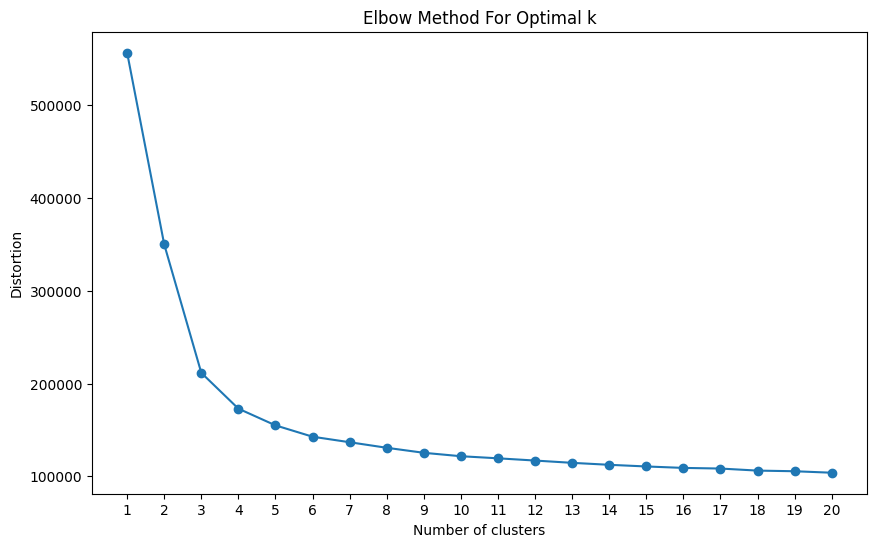

In [ ]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Convert embeddings to numpy array for KMeans
embeddings_np = embeddings.numpy()

# Determine range of k values to try (e.g., 1 to 10)
k_range = range(1, 21)  # Adjust as needed

# Calculate distortion for each value of k
distortions = []
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=0).fit(embeddings_np)
    distortions.append(kmeans.inertia_)

# Plotting the Elbow Method Graph
plt.figure(figsize=(10, 6))
plt.plot(k_range, distortions, marker='o')
plt.title('Elbow Method For Optimal k')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.xticks(k_range)
plt.show()

In [ ]:
from sklearn.cluster import KMeans

# Number of clusters
num_clusters = 21

# Perform KMeans clustering
kmeans = KMeans(n_clusters=num_clusters, random_state=0).fit(embeddings.numpy())

# Add cluster labels to your DataFrame
df['cluster_cleaned_mesage'] = kmeans.labels_


/Users/javiergranados/.pyenv/versions/3.11.3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
# Analyze each cluster
for i in range(num_clusters):
    cluster_sentences = df[df['cluster_cleaned_mesage'] == i]['cleaned_message']
    print(f"Cluster {i}:")
    print(cluster_sentences.sample(min(5, len(cluster_sentences))))  # Print a sample of sentences from the cluster

Cluster 0:
3741    sub Website fname mark lname smith email mark ...
1815    sub Otro fname PABLO lname bARRERA email admin...
2177    sub Oferta laboral fname David lname Beristain...
4253    sub Oferta laboral fname Roberto lname Cazares...
4736    sub Otro fname Karen lname Orozco email korozc...
Name: cleaned_message, dtype: object
Cluster 1:
611     
2204    
1206    
6226    
1797    
Name: cleaned_message, dtype: object
Cluster 2:
2357    Unable to decode UTF 8
5930    Unable to decode UTF 8
5651    Unable to decode UTF 8
3658    Unable to decode UTF 8
6323    Unable to decode UTF 8
Name: cleaned_message, dtype: object
Cluster 3:
2703    Weekly Account Summary May 23 May 29 2022 Here...
1471    Weekly Account Summary February 20 February 26...
4150    Herramientas e inspiraci n para ayudar a que t...
1234    Weekly Account Summary April 17 April 23 2023 ...
2181    Start taking the guesswork out of your marketi...
Name: cleaned_message, dtype: object
Cluster 4:
5971    Hola buen

In [ ]:
df.shape

(6588, 13)

**Observaciones KMeans:**

Para entender los clusters, es relevante observar los patrones comunes de intención del cliente final dentro de cada grupo. Se presentan unas observaciones cada cluster basadas en los fragmentos de mensajes proporcionados:

* Cluster 0 - Contenido Variado: No encontramos un patrón definido para este grupo. Este cluster parece contener mensajes con contenido variado, desde información de sitios web hasta ofertas laborales y otros temas diversos. No relevante para el proyecto.

* Cluster 1 Datos Insuficientes: No encontramos un patrón definido para este grupo.  La información proporcionada para este cluster es limitada, lo que dificulta realizar una conclusión precisa sobre el contenido predominante. Se necesitaría más contexto o ejemplos para interpretar mejor estos mensajes. No relevante para el proyecto.

* Cluster 2 - Problemas de Codificación: Los mensajes en este cluster indican problemas de decodificación UTF-8. Es posible que estos mensajes contengan caracteres no válidos o mal codificados. No relevante para el proyecto.

* Cluster 3 Información Financiera: Este cluster parece contener mensajes relacionados con resúmenes de cuentas semanales, información financiera y herramientas de marketing. Relevante para el proyecto, hay que dar una mirada a profundidad.

* Cluster 4 - Solicitudes y Facturación: Los mensajes en este cluster sugieren solicitudes y consultas relacionadas con facturación y servicio al cliente. Relevante para el proyecto, hay que dar una mirada a profundidad.

* Cluster 5 - Mensaje Estándar: Los mensajes en este cluster parecen ser notificaciones estándar enviadas a destinatarios específicos. Podrían ser mensajes automatizados o de sistema. Relevante para el proyecto, hay que dar una mirada a profundidad.

* Cluster 6 - Ofertas y Enlaces: Este cluster parece contener mensajes relacionados con ofertas, enlaces y llamadas a la acción. Relevante para el proyecto, hay que dar una mirada a profundidad.

* Cluster 7 - Código HTML: Mensajes enfocados a Marketing. Los mensajes en este cluster contienen fragmentos de código HTML. Podrían ser correos electrónicos HTML o mensajes con formato similar. Relevante para el proyecto, hay que dar una mirada a profundidad.


* Cluster 8:- Reservas y Problemas de Acceso: Los mensajes sugieren consultas y problemas relacionados con reservas y acceso a ciertos lugares. Relevante para el proyecto, hay que dar una mirada a profundidad.

* Cluster 9- Comunicación Empresarial: Este cluster parece contener mensajes relacionados con la presentación de la empresa, experiencias positivas y detalles sobre servicios. Relevante para el proyecto, hay que dar una mirada a profundidad.


Estas conclusiones son limitadas, sería útil examinar más ejemplos o contexto para refinar y validar estas interpretaciones. Además, la interpretación exacta puede depender del conocimiento específico del dominio y del propósito del análisis de clusters.


# **Conclusines:**

Este código se empleó para llevar a cabo un análisis de sentimiento en un conjunto de datos de mensajes de correo electrónico de TopGolf. A partir de las observaciones del análisis de sentimiento con BERT (Bidirectional Encoder Representations from Transformers) para cada sub-secuencia del cuerpo del mensaje, los resultados se organizaron en clusters. Se han identificado insights valiosos que contribuyen a la toma de decisiones relacionadas con la construcción del chatbot y sus objetivos, como la atención al cliente, la automatización de respuestas y la comprensión del contenido de los correos electrónicos. Los puntos importantes a resaltar son:

1.	**Diversidad de Contenido**: La muestra de mensajes presenta una diversidad de contenido, abarcando desde consultas de clientes y problemas técnicos hasta ofertas y mensajes estándar. Esto sugiere una amplia variedad de interacciones y temas en los correos electrónicos analizados.
2.	**Importancia de la Clasificación**: La clasificación de mensajes en clusters proporciona una forma efectiva de organizar y entender patrones subyacentes en la base de datos de correos electrónicos. Esto facilita la identificación de temas comunes y la extracción de información relevante.
3.	**Desafíos de Datos No Estructurados**: La presencia de mensajes con problemas de codificación (presentado en el Cluster 2) resalta los desafíos asociados con datos no estructurados y la importancia de abordar problemas de limpieza de datos para obtener análisis más precisos.
4.	**Oportunidades para Mejorar la Atención al Cliente**: el KMeanos arrojo información relevante para la atención al cliente. En específico los Clusters que contienen solicitudes y consultas relacionadas con facturación, reservas y acceso a lugares (por ejemplo, Cluster 4 y Cluster 8) señalan áreas donde una mejora en la automatización de respuestas o la implementación de un chatbot podría tener un impacto positivo en la atención al cliente.
5.	**Contextualización Adicional**: Para una interpretación más precisa y decisiones estratégicas, sería beneficioso examinar más ejemplos de mensajes en cada cluster y contextualizarlos dentro del contexto del negocio y los objetivos específicos del análisis.
